In [89]:
%matplotlib inline

In [90]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
from sets import Set
import community
from community import community_louvain

# Importation des fichiers

#### GRN_edges_S_cerevisiae.txt

In [91]:
edges=pd.read_csv("GRN_edges_S_cerevisiae.txt",header=0)
edges=edges.drop(columns=["Unnamed: 0"])
edges.head()

,transcription_factor,target_gene
0,G15,G1
1,G98,G1
2,G109,G1
3,G22,G9
4,G211,G11


#### net4 transcription factors.tsv

In [92]:
factors=pd.read_csv("net4_transcription_factors.tsv",header=0)
factors.head()

,transcription_factor
0,G1
1,G2
2,G3
3,G4
4,G5


#### net4 gene ids.tsv

In [93]:
geneIDS=pd.read_csv("net4_gene_ids.tsv",sep="\t",header=0)
geneIDS.head()

,ID,Name
0,G1,YHR084W
1,G2,YER109C
2,G3,YDR496C
3,G4,YBR098W
4,G5,YNL139C


####  go slim mapping.tab.txt

In [94]:
mapping=pd.read_csv("go_slim_mapping.tab.txt",sep="\t",header=None)
mapping

,0,1,2,3,4,5,6
0,HRA1,HRA1,S000119380,C,cellular_component,GO:0005575,ncRNA_gene
1,HRA1,HRA1,S000119380,F,molecular_function,GO:0003674,ncRNA_gene
2,HRA1,HRA1,S000119380,P,rRNA processing,GO:0006364,ncRNA_gene
3,HRA1,HRA1,S000119380,P,ribosomal small subunit biogenesis,GO:0042274,ncRNA_gene
4,ICR1,ICR1,S000132612,C,nucleus,GO:0005634,ncRNA_gene
5,ICR1,ICR1,S000132612,F,molecular_function,GO:0003674,ncRNA_gene
6,ICR1,ICR1,S000132612,P,transcription from RNA polymerase II promoter,GO:0006366,ncRNA_gene
7,LSR1,LSR1,S000006478,C,nucleus,GO:0005634,snRNA_gene
8,LSR1,LSR1,S000006478,F,RNA binding,GO:0003723,snRNA_gene
9,LSR1,LSR1,S000006478,P,RNA splicing,GO:0008380,snRNA_gene


In [95]:
#G=nx.from_pandas_dataframe(edges,'transcription_factor','target_gene',create_using=nx.DiGraph())
G=nx.DiGraph()
G.add_nodes_from(list(edges["transcription_factor"]))
G.add_nodes_from(list(edges["target_gene"]))
G.add_edges_from(zip(list(edges["transcription_factor"]),list(edges["target_gene"])))
GU=nx.to_undirected(G)
print(nx.info(G))

Name: 
Type: DiGraph
Number of nodes: 1994
Number of edges: 3940
Average in degree:   1.9759
Average out degree:   1.9759


In [96]:
comp=nx.algorithms.community.centrality.girvan_newman(G)

In [97]:
#t=tuple(sorted(c) for c in next(comp))
#print(t)

In [98]:
#print(t)

In [99]:
total=0
#for l in t :
#    total+=len(l)
total

0

In [100]:
'''communitycolor=[]
for n in G :
    for i in range(len(t)) :
        if n in t[i] :
            communitycolor.append(i)'''

'communitycolor=[]\nfor n in G :\n    for i in range(len(t)) :\n        if n in t[i] :\n            communitycolor.append(i)'

In [101]:
'''
plt.figure(figsize=(150,150))
pos=nx.nx_agraph.graphviz_layout(G)
nx.draw_networkx(G,pos=pos, with_labels=False, node_size=3000,node_color=communitycolor, cmap='gnuplot2')
plt.savefig("G_kshells_layout.png")'''

'\nplt.figure(figsize=(150,150))\npos=nx.nx_agraph.graphviz_layout(G)\nnx.draw_networkx(G,pos=pos, with_labels=False, node_size=3000,node_color=communitycolor, cmap=\'gnuplot2\')\nplt.savefig("G_kshells_layout.png")'

In [102]:
partition = community_louvain.best_partition(GU)

In [103]:
communitycolor=[]
for n in GU :
    communitycolor.append(partition[n])

In [25]:
plt.figure(figsize=(150,150))
pos=nx.nx_agraph.graphviz_layout(GU)
nx.draw_networkx(GU,pos=pos, with_labels=False, node_size=3000,node_color=communitycolor, cmap='gist_ncar')
plt.savefig("G_louvain_gist.png")

In [104]:
dic=dict()
for n in G :
    dic[n]=geneIDS.loc[geneIDS['ID']==n,'Name'].iloc[0]

#print(dic['G3270'])
H=nx.relabel_nodes(GU, dic)

In [106]:
nb_commu=[]
for i in range(1000) :
    partition = community_louvain.best_partition(H)
    nb_commu.append(max(partition.values())+1)

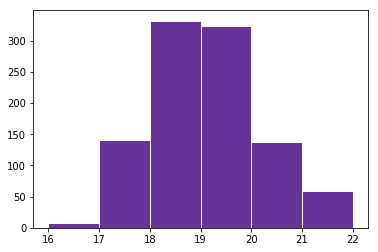

In [108]:
plt.hist(nb_commu,bins=range(min(nb_commu),max(nb_commu)+1),edgecolor='white',color='rebeccapurple')
plt.savefig("communautes.png")

In [18]:
communitycolor=[]
for n in H :
    communitycolor.append(partition[n])

In [69]:
go=[]
for n in H :
    for g in mapping.loc[mapping[0]==n,5] :
            go.append(g)
go=set(go)
print(len(go))
#for gene in partition :
 #   print(mapping.loc[mapping[0]==gene,5].iloc[0])


#matrice.index=partition.keys()
#"""for gene in partition :
    #matrice[mapping.loc[0]==gene,]
 #   matrice[mapping.loc[mapping[0]==gene,5].iloc[0],partition[gene]]+=1"""

166


In [64]:
zero=np.zeros(shape=(len(go),len(set(partition.values()))))
matrice=pd.DataFrame(zero,index=go,columns=set(partition.values()))



In [65]:
for n in H :
    for g in mapping.loc[mapping[0]==n,5] :
        matrice.loc[g,partition[n]]+=1

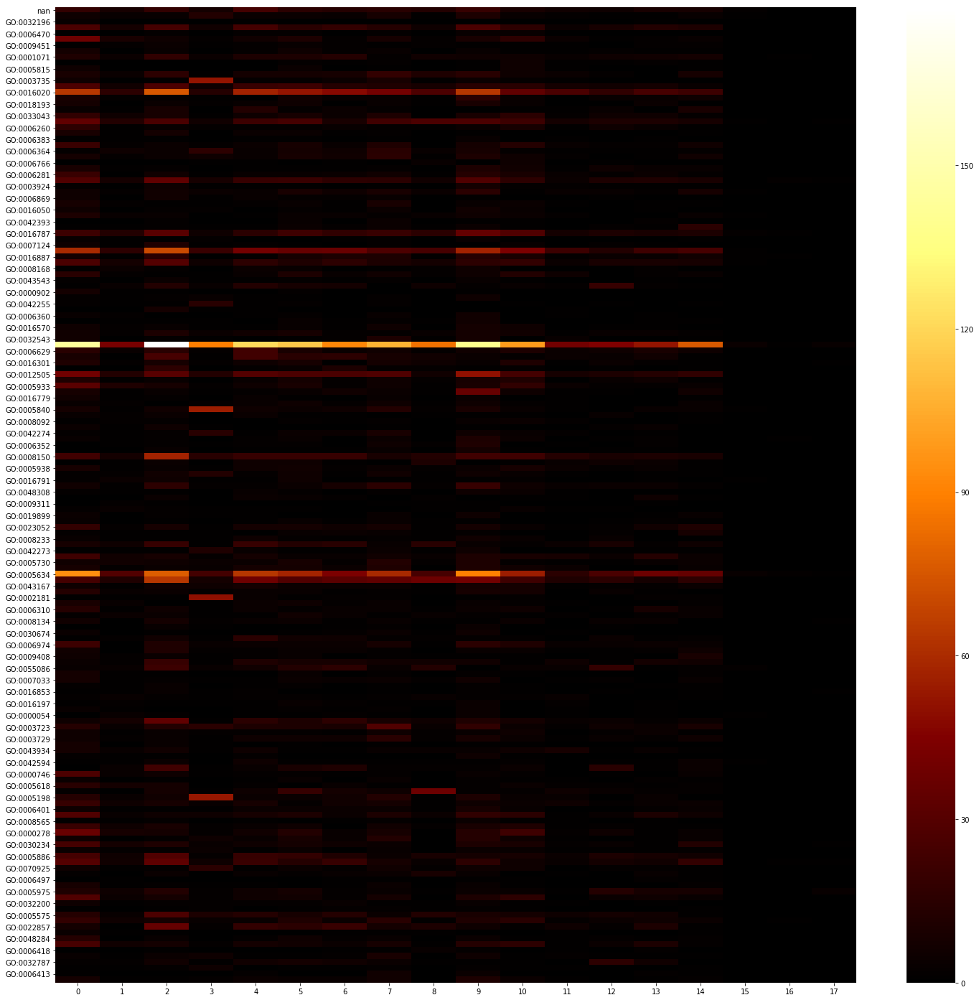

In [66]:
plt.figure(figsize=(25,25))
sns.heatmap(matrice,cmap='afmhot')
plt.savefig("heatmap.png")


In [49]:
matricenorm=matrice.copy()
nbgenes=np.zeros(len(set(partition.values())))
for n in partition :
    nbgenes[partition[n]]+=1

for i in range(len(set(partition.values()))) :
    matricenorm.loc[:,i]/=nbgenes[i]
print(matricenorm)

                  0         1         2         3         4         5   \
NaN         0.080000  0.119403  0.074074  0.062500  0.142857  0.097403   
GO:0051169  0.022222  0.044776  0.012346  0.107143  0.023810  0.025974   
GO:0032196  0.013333  0.000000  0.000000  0.000000  0.005952  0.000000   
GO:0005783  0.115556  0.104478  0.098765  0.053571  0.142857  0.090909   
GO:0006470  0.004444  0.000000  0.008230  0.000000  0.011905  0.012987   
GO:0030427  0.173333  0.134328  0.020576  0.017857  0.035714  0.064935   
GO:0009451  0.004444  0.029851  0.016461  0.008929  0.011905  0.019481   
GO:0061025  0.031111  0.000000  0.012346  0.000000  0.011905  0.032468   
GO:0001071  0.048889  0.059701  0.069959  0.035714  0.059524  0.064935   
GO:0004386  0.000000  0.000000  0.000000  0.000000  0.000000  0.012987   
GO:0005815  0.022222  0.000000  0.000000  0.000000  0.000000  0.025974   
GO:0007005  0.040000  0.059701  0.065844  0.008929  0.041667  0.045455   
GO:0003735  0.022222  0.000000  0.0041

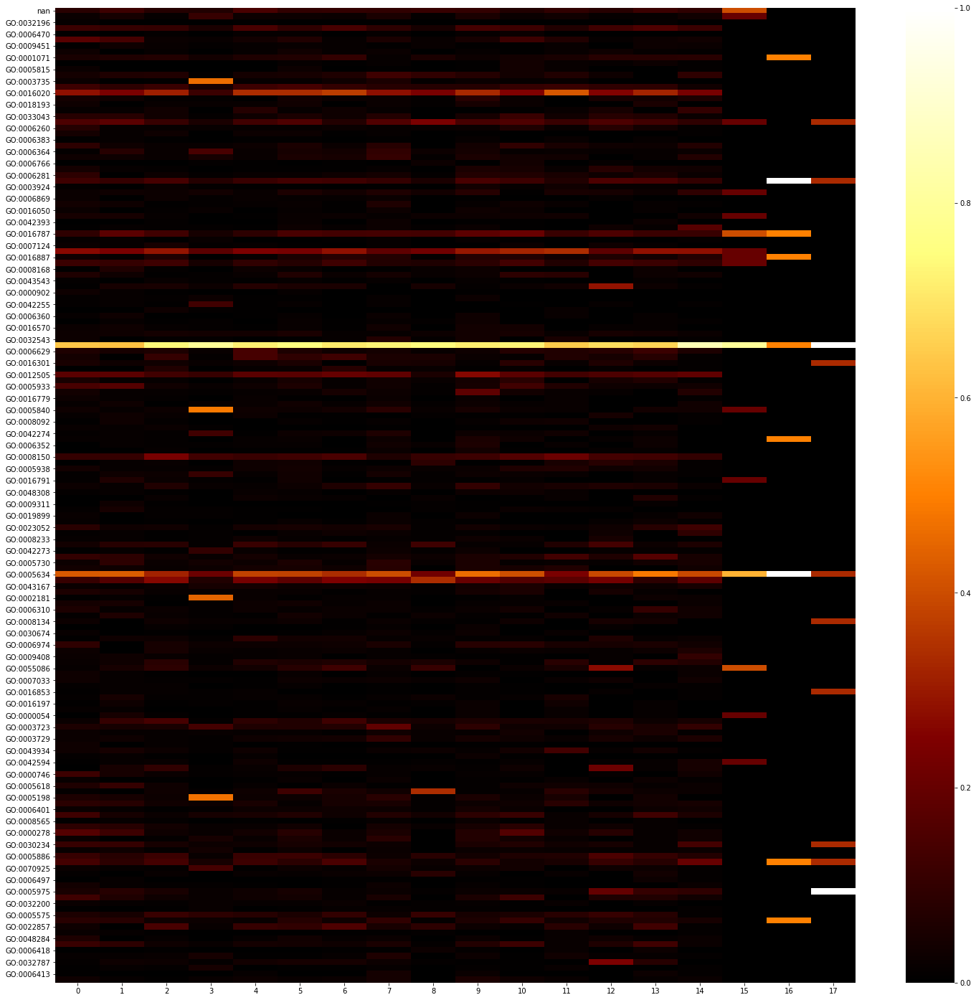

In [50]:
plt.figure(figsize=(25,25))
sns.heatmap(matricenorm,cmap='afmhot')
plt.savefig("heatmap_normalise.png")

In [60]:
sommes=dict()
for i in matricenorm.index :
    sommes[i]=sum(matricenorm.loc[i,:])
for key, value in sorted(sommes.iteritems(), key=lambda (k,v): (v,k)):
    print "%s: %s" % (key, value)

GO:0032196: 0.0321062271062
GO:0008643: 0.0598165690012
GO:0009311: 0.0675934032124
GO:0000902: 0.0682933627452
GO:0008213: 0.0729603873182
GO:0004871: 0.0781891694857
GO:0008135: 0.0783420721626
GO:0006497: 0.078804962964
GO:0006383: 0.0871471150549
GO:0005576: 0.0875279508667
GO:0006470: 0.0886948552432
GO:0042393: 0.0930704625019
GO:0006418: 0.0972382639342
GO:0019843: 0.0996481097993
GO:0006766: 0.101038153673
GO:0005085: 0.101466412952
GO:0007031: 0.103620743467
GO:0043543: 0.110152880999
GO:0006887: 0.110654954483
GO:0008565: 0.111771444031
GO:0006413: 0.114661070278
GO:0032182: 0.118063952056
GO:0030674: 0.121733796004
GO:0007114: 0.12337180188
GO:0005815: 0.124283301657
GO:0006353: 0.124299480791
GO:0043144: 0.1325813007
GO:0019899: 0.133598919964
GO:0005777: 0.137014623607
GO:0006486: 0.138402300296
GO:0006360: 0.142409016937
GO:0016779: 0.142564849107
GO:0006869: 0.142785240496
GO:0001403: 0.142929783056
GO:0048308: 0.143693079222
GO:0004386: 0.144361636021
GO:0006414: 0.1450